In [1]:
import itertools
import numpy as np
import os
import seaborn as sns
from tqdm import tqdm
from dataclasses import asdict, dataclass, field
import vsketch
import shapely.geometry as sg
from shapely.geometry import box, MultiLineString, Point, MultiPoint, Polygon, MultiPolygon, LineString
import shapely.affinity as sa
import shapely.ops as so
import matplotlib.pyplot as plt
import pandas as pd
import networkx as nx
import vpype_cli
from typing import List, Generic
from genpen import genpen as gp, utils as utils
from scipy import stats as ss
import geopandas
from shapely.errors import TopologicalError
import functools
%load_ext autoreload
%autoreload 2

In [2]:
class GraphGram(object):
    
    def __init__(self, graph, xoff=0, yoff=0, scale=1, layout_method='kamada_kawai_layout'):
        self.graph = graph
        self._nodes = None
        self.xoff = xoff
        self.yoff = yoff
        self.scale = scale
        self.layout_method = layout_method
    
    @property
    def center(self):
        return np.array((self.xoff, self.yoff))
    
    @property
    def edges(self):
        return list(self.graph.edges)
    
    @property
    def layout_function(self):
        try:
            f = getattr(nx.layout, self.layout_method)
        except AttributeError:
            layout_functions = [a for a in dir(nx.layout) if 'layout' in a]
            error_string = f'''{self.layout_method} not found in networkx.layout module; 

choose from {layout_functions}
            '''
            print(error_string)
        return f
    
    @functools.lru_cache
    def get_layout(self, *args, **kwargs):
        self._nodes = self.layout_function(
            self.graph,
            scale=self.scale,
            center=self.center,
            *args, **kwargs)
    
    @property
    def nodes(self):
        if self._nodes is None:
            self.get_layout()
        return self._nodes
    
    @property
    def node_pts(self):
        return {k:Point(xy) for k, xy in self.nodes.items()}
    
    @property
    def pts(self):
        return MultiPoint([p for p in self.node_pts.values()])
    
    @property
    def lines(self):
        lines = []
        for n0,n1 in self.edges:
            p0 = self.node_pts[n0]
            p1 = self.node_pts[n1]
            lines.append(LineString([p0, p1]))
        return MultiLineString(lines)    
        

In [38]:
paper_size = '11x14 inches'
border:float=30
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

# strogatz

In [57]:
DEGREE = 33
SCALE = 60
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=30, ystep=30, flatmesh=True)

In [58]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)

In [59]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [60]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [61]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [70]:
buffer_gen = ss.uniform(loc=1, scale=5).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-1., high=-0.3)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.7).rvs

In [71]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(1, cap_style=2, join_style=3)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2).boundary
    
        
    
    
    all_polys = so.unary_union([all_polys, p])

In [72]:
bp = all_polys.buffer(1., cap_style=2, join_style=2).boundary

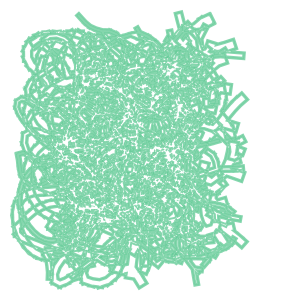

In [73]:
bp

In [74]:
all_fills = gp.make_like(bp, drawbox)

In [75]:
all_fills.bounds

(30.00000000000003, 49.42294489743732, 249.39999999999998, 306.1770551025627)

In [76]:
paper.page_format_mm

'279.4mmx355.59999999999997mm'

In [77]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
sk.geometry(all_fills)
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-11-19T22:38:26.117204 
 
 
 
 
 
 <polygon points="115.0432,467.2903 117.5931,467.3839 118.741,473.6176 115.6762,475.2785 120.7818,484.7001 122.7225,495.2391 126.1508,494.6078 129.7034,501.1635 129.759,501.266 127.1622,504.3672 134.7084,510.686 134.8919,512.2608 135.8998,520.9089 136.3336,524.6313 135.5062,524.8597 136.9843,530.2147 137.6274,535.7326 138.48,535.6332 139.4801,539.2566 141.7998,547.6604 142.8813,551.5787 141.9412,552.0468 144.341,556.867 145.7737,562.0574 146.786,561.778 148.5919,565.4052 149.6588,567.5482 146.5168,572.7921 143.2955,578.1682 141.9301,577.9089 141.2247,581.6241 139.2811,584.8679 140.4733,585.5822 139.2805,591.8654 137.5859,600.7912 136.7325,605.2864 136.3332,605.2446 135.8328,610.0252 134.9363,614.7476 135.3307,614.8225 134.9102,618.841 134.0202,627.3447 133.1642,635.523 131.9465,641.8143 130.6667,648.4267 128.4138,660.0663 130.411,660.4529 129.8864,662.4183 141.4469,665.5039 148.0602,667.2691 154.6674,669.0326 155.6082,670.81 156.0031,670.601 155.6267,671.742 150.2185,688.1384 147.5441,688.3777 148.0978,694.5678 146.1511,700.4699 148.701,701.311 149.1851,706.7232 150.0722,716.6406 151.0479,727.5485 149.1314,731.0335 151.4749,732.3223 151.7132,734.9862 155.6747,734.6318 165.0292,739.7761 166.0139,740.3177 166.7147,741.7891 164.9708,750.0974 163.878,751.5162 159.5076,756.49 159.8292,756.7726 158.2615,758.8078 152.8288,765.8608 151.0715,768.1422 150.5225,767.8007 147.1119,773.2829 143.1719,778.3979 143.6842,778.7925 142.4198,780.8248 137.9739,787.9713 136.2978,790.6654 135.2066,790.2484 133.0549,795.8781 129.8713,800.9954 130.8632,801.6125 130.027,803.8004 127.3188,810.8862 125.6137,815.3477 123.1614,815.6754 123.7642,820.1867 122.1393,824.4382 124.4503,825.3215 124.9595,829.1327 125.8409,835.7286 126.7795,842.7534 125.1627,845.3531 127.3049,846.6854 127.639,849.186 130.6736,848.7805 135.9991,852.0925 140.9572,855.1761 145.9737,858.2959 146.8456,861.2459 149.4699,860.4703 151.7936,861.9155 153.4182,859.3033 159.6112,857.4729 164.2199,856.1108 163.9172,859.05 160.6943,863.1921 163.2832,865.2066 162.832,869.5883 162.062,877.0654 161.6294,881.267 158.7252,882.6178 160.989,887.4848 160.4392,892.8244 163.6252,893.1525 165.5405,897.2704 168.8446,904.374 170.0963,907.0649 168.419,908.7723 172.9697,913.2426 175.6599,919.0266 177.83,918.0172 180.1845,920.3301 186.0107,926.0535 187.2112,927.2329 186.4522,928.3572 189.1987,930.2113 187.5538,936.9988 190.9861,937.8306 191.0296,938.6986 185.4395,942.9251 186.2009,943.9322 180.4811,949.1554 179.595,949.9645 175.8567,948.0371 170.6524,958.1308 162.2664,965.7886 165.1026,968.8945 164.9047,969.2783 160.534,977.7551 159.682,979.4076 154.4834,979.3414 154.351,989.747 149.582,998.9963 154.2029,1001.3789 154.1859,1002.7211 154.0711,1011.7407 154.0482,1013.5406 149.1875,1016.1092 153.9019,1025.0307 153.7735,1035.1204 159.2707,1035.1904 160.191,1036.9319 164.4848,1045.0573 165.1952,1046.4015 162.1682,1050.6353 170.629,1056.6843 175.4884,1065.88 180.0899,1063.4483 181.6235,1064.5448 189.3962,1070.1018 189.839,1070.4184 188.7446,1074.5504 199.6632,1077.4422 208.8515,1084.0113 211.3375,1080.5341 212.6044,1080.8696 222.4424,1083.4752 222.4312,1086.6628 234.6398,1086.7057 246.4416,1089.8314 247.2577,1086.75 247.5207,1086.7509 252.0699,1088.2867 252.5824,1086.7686 258.536,1086.7895 258.9513,1089.808 273.0384,1087.8698 287.1515,1089.6081 287.6126,1085.8645 296.3356,1084.6643 297.3217,1087.4871 305.9362,1084.4778 305.97,1090.1112 317.5957,1090.0414 327.7189,1095.7582 330.9928,1089.9609 332.2889,1089.9531 336.6308,1089.927 338.4742,1093.4824 343.811,1090.7154 346.7578,1095.6874 356.6805,1089.8066 368.2148,1089.7373 368.1743,1082.9946 369.6526,1082.1185 377.8938,1077.2343 380.5078,1079.2076 381.8717,1082.0845 384.1697,1080.995 385.2812,1083.2825 403.3244,1074.5151 404.4793,1076.188 407.4639,1074.1277 407.7918,1074.3263 412.0786,1076.9232 412.8448,1080.1766 416.1604,1079.3958 419.0738,1081.1607 420.8056,1078.30

In [79]:

sk.vpype(f'linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-11-19T22:39:22.527253 
 
 
 
 
 
 <polygon points="115.0432,467.2903 117.5931,467.3839 118.741,473.6176 115.6762,475.2785 120.7818,484.7001 122.7225,495.2391 126.1508,494.6078 129.7034,501.1635 129.759,501.266 127.1622,504.3672 134.7084,510.686 134.8919,512.2608 135.8998,520.9089 136.3336,524.6313 135.5062,524.8597 136.9843,530.2147 137.6274,535.7326 138.48,535.6332 139.4801,539.2566 141.7998,547.6604 142.8813,551.5787 141.9412,552.0468 144.341,556.867 145.7737,562.0574 146.786,561.778 148.5919,565.4052 149.6588,567.5482 146.5168,572.7921 143.2955,578.1682 141.9301,577.9089 141.2247,581.6241 139.2811,584.8679 140.4733,585.5822 139.2805,591.8654 137.5859,600.7912 136.7325,605.2864 136.3332,605.2446 135.8328,610.0252 134.9363,614.7476 135.3307,614.8225 134.9102,618.841 134.0202,627.3447 133.1642,635.523 131.9465,641.8143 130.6667,648.4267 128.4138,660.0663 130.411,660.4529 129.8864,662.4183 141.4469,665.5039 148.0602,667.2691 154.6674,669.0326 155.6082,670.81 156.0031,670.601 155.6267,671.742 150.2185,688.1384 147.5441,688.3777 148.0978,694.5678 146.1511,700.4699 148.701,701.311 149.1851,706.7232 150.0722,716.6406 151.0479,727.5485 149.1314,731.0335 151.4749,732.3223 151.7132,734.9862 155.6747,734.6318 165.0292,739.7761 166.0139,740.3177 166.7147,741.7891 164.9708,750.0974 163.878,751.5162 159.5076,756.49 159.8292,756.7726 158.2615,758.8078 152.8288,765.8608 151.0715,768.1422 150.5225,767.8007 147.1119,773.2829 143.1719,778.3979 143.6842,778.7925 142.4198,780.8248 137.9739,787.9713 136.2978,790.6654 135.2066,790.2484 133.0549,795.8781 129.8713,800.9954 130.8632,801.6125 130.027,803.8004 127.3188,810.8862 125.6137,815.3477 123.1614,815.6754 123.7642,820.1867 122.1393,824.4382 124.4503,825.3215 124.9595,829.1327 125.8409,835.7286 126.7795,842.7534 125.1627,845.3531 127.3049,846.6854 127.639,849.186 130.6736,848.7805 135.9991,852.0925 140.9572,855.1761 145.9737,858.2959 146.8456,861.2459 149.4699,860.4703 151.7936,861.9155 153.4182,859.3033 159.6112,857.4729 164.2199,856.1108 163.9172,859.05 160.6943,863.1921 163.2832,865.2066 162.832,869.5883 162.062,877.0654 161.6294,881.267 158.7252,882.6178 160.989,887.4848 160.4392,892.8244 163.6252,893.1525 165.5405,897.2704 168.8446,904.374 170.0963,907.0649 168.419,908.7723 172.9697,913.2426 175.6599,919.0266 177.83,918.0172 180.1845,920.3301 186.0107,926.0535 187.2112,927.2329 186.4522,928.3572 189.1987,930.2113 187.5538,936.9988 190.9861,937.8306 191.0296,938.6986 185.4395,942.9251 186.2009,943.9322 180.4811,949.1554 179.595,949.9645 175.8567,948.0371 170.6524,958.1308 162.2664,965.7886 165.1026,968.8945 164.9047,969.2783 160.534,977.7551 159.682,979.4076 154.4834,979.3414 154.351,989.747 149.582,998.9963 154.2029,1001.3789 154.1859,1002.7211 154.0711,1011.7407 154.0482,1013.5406 149.1875,1016.1092 153.9019,1025.0307 153.7735,1035.1204 159.2707,1035.1904 160.191,1036.9319 164.4848,1045.0573 165.1952,1046.4015 162.1682,1050.6353 170.629,1056.6843 175.4884,1065.88 180.0899,1063.4483 181.6235,1064.5448 189.3962,1070.1018 189.839,1070.4184 188.7446,1074.5504 199.6632,1077.4422 208.8515,1084.0113 211.3375,1080.5341 212.6044,1080.8696 222.4424,1083.4752 222.4312,1086.6628 234.6398,1086.7057 246.4416,1089.8314 247.2577,1086.75 247.5207,1086.7509 252.0699,1088.2867 252.5824,1086.7686 258.536,1086.7895 258.9513,1089.808 273.0384,1087.8698 287.1515,1089.6081 287.6126,1085.8645 296.3356,1084.6643 297.3217,1087.4871 305.9362,1084.4778 305.97,1090.1112 317.5957,1090.0414 327.7189,1095.7582 330.9928,1089.9609 332.2889,1089.9531 336.6308,1089.927 338.4742,1093.4824 343.811,1090.7154 346.7578,1095.6874 356.6805,1089.8066 368.2148,1089.7373 368.1743,1082.9946 369.6526,1082.1185 377.8938,1077.2343 380.5078,1079.2076 381.8717,1082.0845 384.1697,1080.995 385.2812,1083.2825 403.3244,1074.5151 404.4793,1076.188 407.4639,1074.1277 407.7918,1074.3263 412.0786,1076.9232 412.8448,1080.1766 416.1604,1079.3958 419.0738,1081.1607 420.8056,1078.30

In [80]:
import fn

In [81]:
plot_id = fn.new_plot_id()

saved 20211119-223928_557772-b365a-0a224b to s3://algorithmic-ink/current_plot_id


In [82]:
savedir='/home/naka/art/plotter_svgs'

In [84]:
from pathlib import Path

In [85]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

In [102]:
morsed = all_fills.buffer(1e-2, cap_style=1, join_style=1).buffer(-1e-2, cap_style=1, join_style=1)

In [103]:
morsed

In [111]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
sk.geometry(morsed.boundary)
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-11-19T22:45:37.784425 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="135.9851,360.35 135.9911,360.3444 135.9917,360.3438 135.9921,360.343 136.3455,359.363 136.3469,359.3596 136.3487,359.3563 136.3507,359.3532 136.3531,359.3504 136.3557,359.3477 136.3586,359.3454 136.3617,359.3433 136.365,359.3416 136.3684,359.3402 136.3719,359.3391 136.3756,359.3384 136.3793,359.338 136.383,359.3381 136.3867,359.3384 136.3903,359.3392 136.3939,359.3402 136.3592,359.3277 136.3583,359.3275 136.358,359.3283 135.9948,360.3353 135.9935,360.3386 135.9918,360.3417 135.9898,360.3447 135.9876,360.3475"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="355.5036,217.9264 355.5388,218.0225 355.5391,218.0233 355.5394,218.0225 355.5745,217.9264 355.5731,217.9298 355.5714,217.933 355.5693,217.9361 355.5669,217.9389 355.5643,217.9415 355.5615,217.9439 355.5584,217.9459 355.5551,217.9476 355.5517,217.949 355.5482,217.9501 355.5446,217.9508 355.5409,217.9512 355.5372,217.9512 355.5336,217.9508 355.5299,217.9501 355.5264,217.949 355.523,217.9476 355.5197,217.9459 355.5167,217.9439 355.5138,217.9416 355.5112,217.939 355.5088,217.9361 355.5068,217.9331 355.505,217.9298"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="490.6425,233.9639 490.6909,234.0517 490.6913,234.0523 490.6916,234.0516 490.7126,233.9536 490.7116,233.9571 490.7103,233.9606 490.7087,233.9639 490.7068,233.967 490.7046,233.9699 490.7021,233.9726 490.6994,233.975 490.6964,233.9772 490.6933,233.9791 490.6899,233.9806 490.6865,233.9819 490.6829,233.9827 490.6793,233.9833 490.6756,233.9835 490.672,233.9833 490.6684,233.9828 490.6648,233.9819 490.6613,233.9807 490.658,233.9791 490.6549,233.9772 490.6519,233.9751 490.6491,233.9726 490.6467,233.97 490.6444,233.967"/>
 
 
 
 
 
 
 
 
 
 
 <polygon points="568.4312,242.3752 568.3695,242.4753 568.3691,242.4759 568.3699,242.4757 568.4781,242.4298 568.4746,242.431 568.4711,242.432 568.4675,242.4325 568.4638,242.4328 568.4602,242.4326 568.4565,242.4322 568.4529,242.4313 568.4495,242.4301 568.4461,242.4286 568.4429,242.4268 568.44,242.4247 568.4372,242.4223 568.4347,242.4196 568.4324,242.4167 568.4305,242.4136 568.4288,242.4103 568.4275,242.4069 568.4265,242.4034 568.4258,242.3998 568.4256,242.3961 568.4256,242.3925 568.426,242.3888 568.4268,242.3852 568.4279,242.3817 568.4294,242.3784"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="747.6407,232.771 747.6468,232.7349 747.647,232.734 747.6461,232.7338 747.6423,232.7332 747.6387,232.7323 747.6352,232.7312 747.6318,232.7296 747.6286,232.7278 747.6255,232.7257 747.6227,232.7232 747.6202,232.7205 747.6179,232.7176 747.6159,232.7145 747.6143,232.7111 747.613,232.7077 747.612,232.7041 747.6114,232.7004 747.6111,232.6967 747.6112,232.693 747.6117,232.6894 747.6052,232.7257 747.6051,232.7265 747.606,232.7267 747.61,232.7274 747.6136,232.7283 747.6171,232.7294 747.6205,232.7309 747.6237,232.7328 747.6267,232.7349 747.6295,232.7373 747.6321,232.74 747.6343,232.7429 747.6363,232.746 747.638,232.7493 747.6393,232.7528 747.6403,232.7563 747.6409,232.76 747.6412,232.7636 747.6411,232.7673"/>
 <polygon points="749.7855,220.1751 749.7863,220.1715 749.7874,220.168 749.7889,220.1646 749.7907,220.1613 749.7929,220.1583 749.7953,220.1555 749.7979,220.1529 749.8009,220.1506 749.804,220.1486 749.8073,220.1469 749.8108,220.1456 749.8143,220.1446 749.818,220.144 749.8217,220.1437 749.8254,220.1437 749.8291,220.1442 749.8329,220.1448 749.8337,220.1449 749.8339,220.1441 749.8403,220.108 749.8395,220.1116 749.8383,220.1151 749.8368,220.1185 749.835,220.1217 749.8329,220.1247 749.8305,220.1275 749.8278,220.1301 749.8249,220.1323 749.8217,220.1343 749.8184,220.136 749.815,220.1373 749.8114,220.1383 749.8078,220.1389 749.8041,220.1392 749.8004,220.1391 749.7968,220.1387 749.7927,220.138 749.7918,220.1379 749.7917,220.1388"/>
 
 
 
 
 <polygon poi

In [112]:

sk.vpype(f'linesort')
sk.display()

<?xml version="1.0" encoding="utf-8" ?>
 
 
 
 
 image/svg+xml 
 
 2021-11-19T22:45:47.112745 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="132.2839,370.4147 132.2867,370.4122 132.2898,370.4101 132.2931,370.4083 132.2965,370.4068 132.3001,370.4057 132.3037,370.4049 132.3074,370.4045 132.3112,370.4045 132.3149,370.4048 132.3186,370.4055 132.3222,370.4065 132.3256,370.4079 132.3289,370.4097 132.3321,370.4117 132.335,370.4141 132.3376,370.4167 132.34,370.4196 132.3421,370.4227 132.3439,370.426 132.3453,370.4294 132.3464,370.433 132.3471,370.4366 132.3475,370.4404 132.3475,370.4441 132.3471,370.4478 132.3464,370.4515 132.3453,370.4551 132.3984,370.3078 132.3986,370.3071 132.398,370.3076"/>
 
 
 
 
 
 
 
 <polygon points="158.0486,378.2195 158.0514,378.2171 158.0544,378.215 158.0576,378.2132 158.061,378.2118 158.0644,378.2106 158.068,378.2098 158.0716,378.2094 158.0753,378.2093 158.079,378.2095 158.0826,378.2101 158.0861,378.2111 158.0895,378.2124 158.0928,378.214 158.0959,378.216 158.0989,378.2182 158.1015,378.2207 158.104,378.2234 158.1061,378.2264 158.108,378.2296 158.1095,378.2329 158.1107,378.2364 158.1116,378.2399 158.1121,378.2435 158.1123,378.2472 158.1121,378.2509 158.1115,378.2545 158.1106,378.258 158.1094,378.2615 158.1078,378.2648 158.2146,378.0641 158.2149,378.0635 158.2144,378.064"/>
 
 
 
 
 <polygon points="169.8302,366.4711 169.831,366.4708 169.928,366.4302 169.9245,366.4314 169.9209,366.4324 169.9172,366.4329 169.9135,366.4331 169.9098,366.433 169.9061,366.4324 169.9025,366.4315 169.899,366.4303 169.8956,366.4287 169.8924,366.4268 169.8895,366.4246 169.8867,366.4221 169.8842,366.4194 169.882,366.4164 169.8801,366.4132 169.8785,366.4099 169.8772,366.4064 169.8763,366.4028 169.8757,366.3991 169.8755,366.3954 169.8757,366.3917 169.8763,366.388 169.8771,366.3844 169.8784,366.3809 169.88,366.3776 169.8306,366.4704"/>
 
 
 
 
 
 
 
 
 <polygon points="181.3004,341.8245 181.304,341.8233 181.3076,341.8225 181.3114,341.8221 181.3151,341.822 181.3189,341.8223 181.3226,341.823 181.3262,341.824 181.3296,341.8254 181.333,341.8272 181.3361,341.8292 181.339,341.8316 181.3417,341.8342 181.3441,341.8371 181.3462,341.8402 181.348,341.8435 181.3494,341.847 181.3505,341.8505 181.3513,341.8542 181.3516,341.858 181.3516,341.8617 181.3513,341.8654 181.3505,341.8691 181.3494,341.8727 181.3479,341.8762 181.3462,341.8795 181.344,341.8826 181.4228,341.7783 181.4232,341.7777 181.4224,341.7779"/>
 
 
 
 
 
 
 <polygon points="205.1991,327.4062 205.1995,327.4061 206.043,327.0616 206.0395,327.0628 206.0359,327.0637 206.0322,327.0642 206.0285,327.0644 206.0248,327.0642 206.0211,327.0636 206.0175,327.0627 206.014,327.0614 206.0106,327.0598 206.0074,327.0578 206.0045,327.0556 206.0017,327.053 205.9993,327.0502 205.9971,327.0472 205.9952,327.044 205.9936,327.0406 205.9924,327.0371 205.9916,327.0335 205.9911,327.0298 205.9909,327.026 205.9912,327.0223 205.9918,327.0186 205.9928,327.015 205.9941,327.0115 205.9957,327.0082 205.9977,327.005 206.0,327.0021 206.0025,326.9994 206.0053,326.9969 206.0084,326.9948 206.0116,326.9929 205.1995,327.406"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="226.1593,318.8455 226.4813,318.7059 226.4819,318.7056 226.4812,318.7057 226.1907,318.7509 226.1944,318.7505 226.1982,318.7504 226.2019,318.7508 226.2056,318.7515 226.2092,318.7526 226.2127,318.754 226.216,318.7558 226.2191,318.7579 226.222,318.7603 226.2247,318.763 226.227,318.7659 226.2291,318.7691 226.2308,318.7724 226.2322,318.7759 226.2333,318.7795 226.234,318.7832 226.2343,318.787 226.2342,318.7907 226.2338,318.7945 226.233,318.7981 226.2318,318.8017 226.2303,318.8051 226.2284,318.8084 226.2263,318.8115 226.2238,318.8143 226.2211,318.8169 226.2181,318.8192 226.2149,318.8212 226.2115,318.8229"/>
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 
 <polygon points="282.1055,3

In [113]:
plot_id = fn.new_plot_id()

saved 20211119-224551_056637-b365a-12c875 to s3://algorithmic-ink/current_plot_id


In [114]:
savedir='/home/naka/art/plotter_svgs'

In [115]:
from pathlib import Path

In [110]:
savepath = Path(savedir).joinpath(f'{plot_id}.svg').as_posix()
sk.save(savepath)

# Try 3

In [ ]:
# make page
paper_size = 'A2'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border).buffer(-60)

In [ ]:
DEGREE = 33
SCALE = 60
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=20, ystep=20, flatmesh=True)

In [ ]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)

In [ ]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [ ]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [ ]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [ ]:
buffer_gen = ss.uniform(loc=1, scale=6).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.8, high=-0.2)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.6).rvs

In [ ]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(0.5, cap_style=2, join_style=3)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

In [ ]:
all_fills = gp.merge_LineStrings(fills)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
sk.geometry(all_fills)

tolerance= 0.1
sk.vpype(f'linemerge --tolerance {tolerance}mm linesimplify --tolerance {tolerance}mm')
sk.vpype(f'linemerge --tolerance {tolerance}mm linesimplify --tolerance {tolerance}mm')
sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0313_flow_beam_graphs_simpler.svg'

sk.save(savepath)

# Try 2

In [ ]:
# make page
paper_size = 'A2'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border).buffer(-60)

In [ ]:
DEGREE = 33
SCALE = 40
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=30, ystep=30, flatmesh=True)

In [ ]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)

In [ ]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [ ]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [ ]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [ ]:
buffer_gen = ss.uniform(loc=4, scale=9).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-2.2, high=-1.1)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.6).rvs

In [ ]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(0.5, cap_style=1, join_style=1)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

In [ ]:
fills = [f for f in fills if f.length > 0]

In [ ]:
all_fills = gp.merge_LineStrings(fills)

In [ ]:
fb = all_fills.buffer(0.2).boundary

In [ ]:
fbm =  all_fills.buffer(0.2).buffer(-0.2).boundary

In [ ]:
fbm = gp.merge_LineStrings([f for f in fbm if f.length>0.1])

In [ ]:
fbmb = fbm.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
# sk.geometry(all_fills)
sk.geometry(fbmb)
# sk.vpype('splitall')
# for tolerance in [0.1, 0.2, 0.4, 0.8, 1]:
#     sk.vpype(f'linemerge --tolerance {tolerance}mm ')
# sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0316_flow_beam_graphs_morsed_connected.svg'

sk.save(savepath)

# Try 2

In [ ]:
# make page
paper_size = '11x14 inches'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border).buffer(-10)

In [ ]:
DEGREE = 33
SCALE = 30
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=30, ystep=30, flatmesh=True)

In [ ]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)

In [ ]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [ ]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [ ]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [ ]:
buffer_gen = ss.uniform(loc=2, scale=6).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-2.2, high=-1.1)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.6).rvs

In [ ]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(0.5, cap_style=1, join_style=1)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

In [ ]:
fills = [f for f in fills if f.length > 0]

In [ ]:
all_fills = gp.merge_LineStrings(fills)

In [ ]:
fb = all_fills.buffer(0.2).boundary

In [ ]:
fbm =  all_fills.buffer(0.2).buffer(-0.2).boundary

In [ ]:
fbm = gp.merge_LineStrings([f for f in fbm if f.length>0.1])

In [ ]:
fbmb = fbm.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
# sk.geometry(all_fills)
sk.geometry(fbmb)
sk.vpype('splitall')
for tolerance in tqdm([0.1, 0.2, ]):
    sk.vpype(f'linemerge --tolerance {tolerance}mm ')
sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0317_flow_beam_graphs_morsed_connected.svg'

sk.save(savepath)

# Try 2

In [ ]:
# make page
paper_size = '11x14 inches'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border).buffer(-20)

In [ ]:
DEGREE = 33
SCALE = 30
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=60, ystep=60, flatmesh=True)

In [ ]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)

In [ ]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [ ]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [ ]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [ ]:
buffer_gen = ss.uniform(loc=2, scale=6).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-2.2, high=-0.3)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.6).rvs

In [ ]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(0.5, cap_style=1, join_style=1)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

In [ ]:
fills = [f for f in fills if f.length > 0]

In [ ]:
all_fills = gp.merge_LineStrings(fills)

In [ ]:
fb = all_fills.buffer(0.2).boundary

In [ ]:
fbm =  all_fills.buffer(0.2).buffer(-0.2).boundary

In [ ]:
fbm = gp.merge_LineStrings([f for f in fbm if f.length>0.1])

In [ ]:
fbmb = fbm.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
# sk.geometry(all_fills)
sk.geometry(fbmb)
# sk.vpype('splitall')
# for tolerance in tqdm([0.1, 0.2, ]):
#     sk.vpype(f'linemerge --tolerance {tolerance}mm ')
sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0318_flow_beam_graphs_morsed_connected.svg'

sk.save(savepath)

# Try 2

In [ ]:
# make page
paper_size = '11x14 inches'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border).buffer(-20)

In [ ]:
DEGREE = 37
SCALE = 50
(xbins, ybins), (xs, ys) = gp.overlay_grid(drawbox, xstep=200, ystep=100, flatmesh=True)

In [ ]:
p_gen = lambda x: np.interp(x, [xs.min(), xs.max()], [0., 0.6] )
_p_gen = gp.make_callable(p_gen)
_p_gen = gp.make_callable(0)

In [ ]:
k_gen = 2
_k_gen = gp.make_callable(k_gen)

In [ ]:
df = pd.DataFrame({
    'x':xs,
    'y':ys,
    'k':_k_gen(xs),
    'p':_p_gen(xs)
})
df['k'] = df['k'].astype(int)

In [ ]:
new_rows = []
for i, row in df.iterrows():
    k = row['k'].astype(int)
    G = nx.connected_watts_strogatz_graph(n=DEGREE, k=k, p=row['p'])
    gg = GraphGram(graph=G, layout_method='spring_layout',
                   xoff=row['x'], yoff=row['y'], scale=SCALE)
    
    bezs = []
    for ls in gg.lines:
        bez = gp.LineString_to_jittered_bezier(
            ls, xstd=0., ystd=0., normalized=True, n_eval_points=4)
        bezs.append(bez)
    bezs = gp.merge_LineStrings(bezs)
    new_row = row.to_dict()
    new_row['geometry'] = bezs
    new_rows.append(new_row)
    
gdf = geopandas.GeoDataFrame(new_rows)
layers = []
layers.append(gp.merge_LineStrings(gdf.geometry))

In [ ]:
buffer_gen = ss.uniform(loc=4, scale=6).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.6, high=-0.4)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.5, scale=0.8).rvs

In [ ]:
fills = []
all_polys = Polygon()
for i, row in gdf.iterrows():
    p = row.geometry.buffer(0.5, cap_style=1, join_style=1)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

In [ ]:
fills = [f for f in fills if f.length > 0]

In [ ]:
all_fills = gp.merge_LineStrings(fills)

In [ ]:
fb = all_fills.buffer(0.2).boundary

In [ ]:
fbm =  all_fills.buffer(0.2).buffer(-0.2).boundary

In [ ]:
fbm = gp.merge_LineStrings([f for f in fbm if f.length>0.1])

In [ ]:
fbmb = fbm.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
sk.geometry(all_fills)
sk.geometry(fbmb)
sk.vpype('splitall')
for tolerance in tqdm([0.1, 0.2, ]):
    sk.vpype(f'linemerge --tolerance {tolerance}mm ')
sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0319_flow_beam_graphs_morsed_connected.svg'

sk.save(savepath)

# bezier seed

In [ ]:
# make page
paper_size = '11x14 inches'
border:float=20
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)

In [ ]:
fills = gp.BezierHatchFill(
    drawbox,
    xjitter_func=ss.norm(loc=0, scale=0.1).rvs,
    yjitter_func=ss.norm(loc=0., scale=0.5).rvs,
    degrees=0,
    spacing=1,
    fill_inscribe_buffer=1.5,
    n_eval_points=100
)

In [ ]:
l1 = fills.fill

In [ ]:
fills = gp.BezierHatchFill(
    drawbox,
    xjitter_func=ss.norm(loc=0, scale=0.1).rvs,
    yjitter_func=ss.norm(loc=0., scale=1).rvs,
    degrees=0,
    spacing=1,
    fill_inscribe_buffer=1.5,
    n_eval_points=100
)

In [ ]:
l2 = fills.fill

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.stroke(1)
sk.geometry(l1)
sk.geometry(l2)
# sk.geometry(fbmb)
# sk.vpype('splitall')
for tolerance in tqdm([1, 2, 4]):
    sk.vpype(f'linemerge --tolerance {tolerance}mm ')
sk.vpype('linesort')
sk.display()

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0321_bez_fill.svg'

sk.save(savepath)

# old magic

In [ ]:
paper_size = '11x14 inches'
border:float=30
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*1/2, np.pi*3/2])

In [ ]:
f,ax = plt.subplots(figsize=(6,6))
ax.quiver(np.cos(pg.a), np.sin(pg.a), scale=50)
ax.axis('square')

In [ ]:
min_dim = np.min([gp.get_width(poly), gp.get_height(poly)])
start_area = poly.centroid.buffer(min_dim/1.8)

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(start_area, xstep=7, ystep=13)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*0.6, y+np.random.randn()*0.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
yrange = [pg.p.bounds[1], pg.p.bounds[3]]
xrange = [pg.p.bounds[0], pg.p.bounds[2]]

In [ ]:
for p in tqdm(particles):
    nsteps = int(np.interp(p.x, xrange, [1,60]))
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

# base.merge_LineStrings([lss, pg.p.boundary])
lss

In [ ]:
lbs = []
for ls in tqdm(lss):
    b = np.interp(ls.centroid.y, yrange, [0.5, 2.2])
    bs = 2
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))
    
lbm = so.unary_union(lbs)
lbm

In [ ]:
ssp_sets = []
for p in lbm:
    db = np.interp(p.centroid.y, yrange, [-0.6, -0.12])
    n_scale_shifts = 25
    d_buffers = np.array([0.] + [db] * n_scale_shifts)
    d_translates = d_buffers * 0.8
    angles = gp.make_callable(np.radians(-45))
    
    stp = gp.ScaleTransPrms(angles=angles, n_iters=1900, d_buffer=db, d_translate_factor=0.8)
#     stp.d_buffers = d_buffers
#     stp.d_translates = d_translates
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    ssp_sets.append(gp.merge_LineStrings(P.fill))
    
fills = gp.merge_LineStrings(ssp_sets)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.geometry(fills)
sk.vpype('linemerge linesort')
sk.display(color_mode='none')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0322_perlin_flow_beam_erods.svg'

sk.save(savepath)

# old magic

In [ ]:
paper_size = '11x14 inches'
border:float=30
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*0, np.pi*1])

In [ ]:
f,ax = plt.subplots(figsize=(6,6))
ax.quiver(np.cos(pg.a), np.sin(pg.a), scale=50)
ax.axis('square')

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=9, ystep=9)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*4.6, y+np.random.randn()*4.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=2)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = 60
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

In [ ]:
lss = MultiLineString([l for l in lss if l.distance(poly.centroid) < 50])

In [ ]:
yrange = [pg.p.bounds[1], pg.p.bounds[3]]
xrange = [pg.p.bounds[0], pg.p.bounds[2]]

In [ ]:
lbs = []
for ls in tqdm(lss):
    b = np.interp(ls.centroid.y, yrange, [0.5, 2.2])
    bs = 2
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))

In [ ]:
ssp_sets = []
for p in lbs:
    db = np.interp(p.centroid.y, yrange, [-0.6, -0.12])
    angles = np.radians(-45)
    
    stp = gp.ScaleTransPrms(angles=angles, n_iters=1900, d_buffer=db, d_translate_factor=0.7)
#     stp.d_buffers = d_buffers
#     stp.d_translates = d_translates
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    ssp_sets.append(gp.merge_LineStrings(P.fill))
    
fills = gp.merge_LineStrings(ssp_sets)

In [ ]:
buffer_gen = ss.uniform(loc=0.5, scale=3).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.8, high=-0.2)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(80)
d_translate_factor_gen = ss.uniform(loc=0.2, scale=0.6).rvs

In [ ]:
fills = []
all_polys = Polygon()
for ls in lbs:
    p = ls.buffer(0.5, cap_style=2, join_style=2)
    p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.15, 0.15, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

fills = [f for f in fills if f.length > 0]

all_fills = gp.merge_LineStrings(fills)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.geometry(all_fills)
sk.vpype('linesimplify linesort')
sk.display(color_mode='none')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0323_perlin_flow_beam_erodes.svg'

sk.save(savepath)

# old magic

In [ ]:
paper_size = '11x14 inches'
border:float=35
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*1/2, np.pi*5/2])

In [ ]:
f,ax = plt.subplots(figsize=(6,6))
ax.quiver(np.cos(pg.a), np.sin(pg.a), scale=50)
ax.axis('square')

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=7, ystep=7)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*4.6, y+np.random.randn()*4.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = 90
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

In [ ]:
mid_area = pg.p.centroid.buffer(80)
_lss = MultiLineString([l for l in lss if l.intersects(mid_area)])
_lss

In [ ]:
yrange = [_lss.bounds[1], _lss.bounds[3]]
xrange = [_lss.bounds[0], _lss.bounds[2]]

In [ ]:
lbs = []
for ls in tqdm(_lss):
    b = np.interp(ls.centroid.x, xrange, [1.5, 6])
    bs = 2
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))

In [ ]:
buffer_gen = ss.uniform(loc=0.5, scale=3).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.5, high=-0.1)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(45)
d_translate_factor_gen = ss.uniform(loc=0.4, scale=0.8).rvs

In [ ]:
fills = []
all_polys = Polygon()
for ls in lbs:
#     p = ls.buffer(0.5, cap_style=2, join_style=2)
#     p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    p = ls
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.05, 0.05, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

fills = [f for f in fills if f.length > 0]

all_fills = gp.merge_LineStrings(fills)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.geometry(all_fills)
sk.display(color_mode='none')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0328_perlin_flow_beam_erodes.svg'

sk.save(savepath)

# old magic with background

In [ ]:
paper_size = '6x9 inches'
border:float=15
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*0/2, np.pi*4/2])

In [ ]:
db = gp.Shape(poly)

In [ ]:
flow_start_ygen = ss.triang(c=1, loc=db.bottom, scale=db.height).rvs

start_pts = gp.get_random_points_in_polygon(db.p, n_points=1600, ygen=flow_start_ygen)

particles = [gp.Particle(p, grid=pg, stepsize=1) for p in start_pts if pg.p.contains(p)]

for p in tqdm(particles):
    nsteps = 20
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

bg1 = lss.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
bg1

In [ ]:
flow_start_ygen = ss.triang(c=0, loc=db.bottom, scale=db.height).rvs

start_pts = gp.get_random_points_in_polygon(db.p, n_points=1600, ygen=flow_start_ygen)

particles = [gp.Particle(p, grid=pg, stepsize=1) for p in start_pts if pg.p.contains(p)]

for p in tqdm(particles):
    nsteps = 20
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

bg2 = lss.buffer(0.2, cap_style=2, join_style=2).boundary

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=3, ystep=3)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*9.6, y+np.random.randn()*9.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = np.random.randint(1, 10)
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

In [ ]:
mid_area = pg.p.centroid.buffer(40)
_lss = MultiLineString([l for l in lss if l.intersects(mid_area)])
_lss

In [ ]:
yrange = [_lss.bounds[1], _lss.bounds[3]]
xrange = [_lss.bounds[0], _lss.bounds[2]]

In [ ]:
lbs = []
for ls in tqdm(_lss):
    b = np.interp(ls.centroid.x, xrange, [1.5, 6])
    bs = 2
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))

In [ ]:
buffer_gen = ss.uniform(loc=0.5, scale=19).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.5, high=-0.1)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(45)
d_translate_factor_gen = ss.uniform(loc=0.4, scale=0.8).rvs

In [ ]:
fills = []
all_polys = Polygon()
for ls in lbs:
#     p = ls.buffer(0.5, cap_style=2, join_style=2)
#     p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    p = ls
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.05, 0.05, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

fills = [f for f in fills if f.length > 0]

all_fills = gp.merge_LineStrings(fills)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.stroke(1)
sk.geometry(bg1)
sk.stroke(2)
sk.geometry(bg2)
sk.stroke(3)
sk.geometry(all_fills)
sk.vpype('linesimplify linemerge linesort')
sk.display(color_mode='layer')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0333_perlin_flow_beam_erodes.svg'

sk.save(savepath)

# old magic with background

In [ ]:
paper_size = '6x9 inches'
border:float=15
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*0/2, np.pi*4/2])

In [ ]:
db = gp.Shape(poly)

In [ ]:
start = 15
n_lines = 300
spacings = db.bottom + (np.geomspace(start, db.height, n_lines) - start)

fills = gp.BezierHatchFill(
    drawbox.buffer(10),
    xjitter_func=ss.norm(loc=0, scale=0.).rvs,
    yjitter_func=ss.norm(loc=0., scale=0.1).rvs,
    degrees=0,
    spacing=spacings,
    fill_inscribe_buffer=1.,
    n_eval_points=100
)
l1 = fills.fill.intersection(drawbox)

In [ ]:
start = 15
n_lines = 300
spacings = db.top - (np.geomspace(start, db.height, n_lines) - start)
fills = gp.BezierHatchFill(
    drawbox,
    xjitter_func=ss.norm(loc=0, scale=0.).rvs,
    yjitter_func=ss.norm(loc=0., scale=0.1).rvs,
    degrees=0,
    spacing=spacings,
    fill_inscribe_buffer=1,
    n_eval_points=100
)
l2 = fills.fill.intersection(drawbox)

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=4, ystep=4)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*9.6, y+np.random.randn()*9.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = np.random.randint(1, 40)
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

In [ ]:
mid_area = pg.p.centroid.buffer(40)
_lss = MultiLineString([l for l in lss if l.intersects(mid_area)])
_lss

In [ ]:
yrange = [_lss.bounds[1], _lss.bounds[3]]
xrange = [_lss.bounds[0], _lss.bounds[2]]

In [ ]:
lbs = []
for ls in tqdm(_lss):
    b = np.interp(ls.centroid.x, xrange, [1.5, 6])
    bs = 2
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))

In [ ]:
buffer_gen = ss.uniform(loc=0.5, scale=20).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.5, high=-0.1)
angles_gen = ss.uniform(loc=0, scale=360).rvs
angles_gen = gp.make_callable(45)
d_translate_factor_gen = ss.uniform(loc=0.4, scale=0.8).rvs

In [ ]:
fills = []
all_polys = Polygon()
for ls in lbs:
#     p = ls.buffer(0.5, cap_style=2, join_style=2)
#     p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    p = ls
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.05, 0.05, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

fills = [f for f in fills if f.length > 0]

all_fills = gp.merge_LineStrings(fills).intersection(drawbox)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.stroke(1)
sk.geometry(l1)
sk.stroke(2)
sk.geometry(l2)
for tol in [0.1, 0.2, 0.4, 0.6, 1, 2, 4, 8]:
    sk.vpype(f'linemerge -t {tol}')
sk.vpype('linesort')
sk.stroke(3)
sk.geometry(all_fills)
sk.vpype('linesort')
sk.display(color_mode='layer')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0332_perlin_flow_beam_erodes.svg'

sk.save(savepath)

# old magic with background

In [ ]:
paper_size = '6x9 inches'
border:float=15
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [ ]:

poly = drawbox
pg = gp.PerlinGrid(poly, xstep=3, ystep=3, lod=10, falloff=None, noise_scale=0.0093, noiseSeed=5)

In [ ]:
pg.a = np.interp(pg.a, [0, np.pi*2], [np.pi*0.2/2, np.pi*2/2])

In [ ]:
db = gp.Shape(poly)

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=2, ystep=2)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*0.1, y+np.random.randn()*0.1)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = 20
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

bg1 = lss.buffer(0.05, cap_style=2, join_style=2).boundary.intersection(drawbox)

In [ ]:
bg1

In [ ]:
(xcs, ycs), _ = gp.overlay_grid(poly, xstep=4, ystep=4)
particles = []
for x,y in itertools.product(xcs,ycs):
    pos = (x+np.random.randn()*9.6, y+np.random.randn()*9.6)
    p = gp.Particle(pos=pos,
                 grid=pg, stepsize=1)
    if pg.p.contains(p.pos):
        particles.append(p)

In [ ]:
for p in tqdm(particles):
    nsteps = np.random.randint(1, 15)
    for i in range(nsteps):
        p.step()
    
lss = MultiLineString([LineString(p.pts) for p in particles if len(p.pts) > 1])

In [ ]:
mid_area = pg.p.centroid.buffer(40)
_lss = MultiLineString([l for l in lss if l.intersects(mid_area)])
_lss

In [ ]:
yrange = [_lss.bounds[1], _lss.bounds[3]]
xrange = [_lss.bounds[0], _lss.bounds[2]]

In [ ]:
lbs = []
for ls in tqdm(_lss):
    b = np.interp(ls.centroid.x, xrange, [1.5, 5])
    bs = 1
    lbs.append(ls.buffer(b, cap_style=bs, join_style=bs))

In [ ]:
buffer_gen = ss.uniform(loc=0.5, scale=29).rvs
d_buffer_gen = functools.partial(np.random.uniform, low=-0.6, high=-0.15)
angles_gen = ss.uniform(loc=0, scale=360).rvs
# angles_gen = gp.make_callable(45)
d_translate_factor_gen = ss.uniform(loc=0.4, scale=0.8).rvs

In [ ]:
fills = []
all_polys = Polygon()
for ls in lbs:
#     p = ls.buffer(0.5, cap_style=2, join_style=2)
#     p = p.buffer(buffer_gen(), cap_style=2, join_style=2)
    p = ls
    stp = gp.ScaleTransPrms(d_buffer=d_buffer_gen(),angles=angles_gen(),d_translate_factor=d_translate_factor_gen(), n_iters=300)
    stp.d_buffers += np.random.uniform(-0.05, 0.05, size=stp.d_buffers.shape)
    P = gp.Poly(p)
    P.fill_scale_trans(**stp.prms)
    
    visible_area = p.difference(all_polys)
    visible_fill = P.fill.intersection(visible_area.buffer(1e-6))
        
    
    fills.append(visible_fill)
    all_polys = so.unary_union([all_polys, p])

fills = [f for f in fills if f.length > 0]

all_fills = gp.merge_LineStrings(fills).intersect(drawbox)

In [ ]:
sk = vsketch.Vsketch()
sk.size(paper.page_format_mm)
sk.scale('1mm')
sk.penWidth('0.25mm')
sk.stroke(1)
sk.geometry(bg1)
# sk.stroke(2)
# sk.geometry(bg2)
sk.stroke(3)
sk.geometry(all_fills)
sk.vpype('linesimplify linemerge linesort')
sk.display(color_mode='layer')

In [ ]:
savepath = '/Users/naka/code/side/plotter_images/oned_outputs/0336_perlin_flow_beam_erodes.svg'

sk.save(savepath)